### Dataset EDA

In [1]:
import pandas as pd
import numpy as np
import networkx as nx
from geopy.geocoders import Nominatim

In [ ]:
df = pd.read_csv("Airports2.csv")
df.head()

,Origin_airport,Destination_airport,Origin_city,Destination_city,Passengers,Seats,Flights,Distance,Fly_date,Origin_population,Destination_population,Org_airport_lat,Org_airport_long,Dest_airport_lat,Dest_airport_long
0,MHK,AMW,"Manhattan, KS","Ames, IA",21,30,1,254,2008-10-01,122049,86219,39.140999,-96.670799,NaN,NaN
1,EUG,RDM,"Eugene, OR","Bend, OR",41,396,22,103,1990-11-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
2,EUG,RDM,"Eugene, OR","Bend, OR",88,342,19,103,1990-12-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
3,EUG,RDM,"Eugene, OR","Bend, OR",11,72,4,103,1990-10-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
4,MFR,RDM,"Medford, OR","Bend, OR",0,18,1,156,1990-02-01,147300,76034,42.374199,-122.873001,44.254101,-121.150002


In [ ]:
df.shape

(3606803, 15)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3606803 entries, 0 to 3606802
Data columns (total 15 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   Origin_airport          object 
 1   Destination_airport     object 
 2   Origin_city             object 
 3   Destination_city        object 
 4   Passengers              int64  
 5   Seats                   int64  
 6   Flights                 int64  
 7   Distance                int64  
 8   Fly_date                object 
 9   Origin_population       int64  
 10  Destination_population  int64  
 11  Org_airport_lat         float64
 12  Org_airport_long        float64
 13  Dest_airport_lat        float64
 14  Dest_airport_long       float64
dtypes: float64(4), int64(6), object(5)
memory usage: 412.8+ MB


### Dataset Preprocessing

Search for rows where at least one origin coordinates column is NaN

In [ ]:
# Filter rows where at least one between 'Org_airport_lat' or 'Org_airport_long' columns is Nan
origin_nan = df[df[['Org_airport_lat', 'Org_airport_long']].isnull().any(axis=1)][['Origin_airport', 'Origin_city']]

# Print results
print("Origin with NaN in coordinates:")
origin_nan = origin_nan.drop_duplicates()
origin_nan

Origin with NaN in coordinates:


,Origin_airport,Origin_city
945,RBG,"Roseburg, OR"
1288,DQF,"Phoenix, AZ"
8537,PRB,"San Luis Obispo, CA"
9626,PNC,"Ponca City, OK"
9643,WDG,"Enid, OK"
...,...,...
3397749,LHV,"Lock Haven, PA"
3399954,CRE,"Myrtle Beach, SC"
3404373,BOK,"Brookings, OR"
3494631,MQJ,"Indianapolis, IN"


Same process for destination coordinates columns

In [ ]:
destination_nan = df[df[['Dest_airport_lat', 'Dest_airport_long']].isnull().any(axis=1)][['Destination_airport', 'Destination_city']]

print("\nDestination with NaN in coordinates:")
destination_nan = destination_nan.drop_duplicates(ignore_index=True)
destination_nan


Destination with NaN in coordinates:


,Destination_airport,Destination_city
0,AMW,"Ames, IA"
1,WDG,"Enid, OK"
2,END,"Enid, OK"
3,AOH,"Lima, OH"
4,RMG,"Rome, GA"
...,...,...
219,MPS,"Mount Pleasant, TX"
220,KY3,"Mount Sterling, KY"
221,PRB,"San Luis Obispo, CA"
222,PHD,"New Philadelphia, OH"


#### Geographic Coordinates Retrieval Script

This script uses the `geopy.geocoders` library to retrieve coordinate information based on geographic strings such as `"FCO Airport, Rome"`, `"Rome Airport, Rome, Italy"` or, as a last resort, `"Rome, Italy"` coordinates. If no information is found, it returns a `None` object.

The script implements a **try-except process** to test, as we said, three different geographic string formats to retrieve the desired information. This approach is designed to fill missing coordinate values in our incomplete dataset.

**Process Overview**

1. **First Attempt:**
   - Use the string `"{Airport Code} Airport, {State}, USA"`.
   - Example: `"AMW Airport, IA, USA"`.
   - If no information is found, proceed to the next string format.

2. **Second Attempt:**
   - Use the string `"{City} Airport, {State}, USA"`.
   - Example: `"Ames Airport, IA, USA"`.
   - If no information is found, proceed to the next string format.

3. **Third and Final Attempt:**
   - Use the string `"{City}, {State}, USA"`.
   - Example: `"Ames, IA, USA"`.
   - This fallback method provides general city coordinates. If still unsuccessful, the script saves the information available.
   - Since city coordinates might overlap when visualized on a map, the script may apply a small shift to ensure nodes don't overlap.

This approach ensures that most missing values can be filled accurately while minimizing errors.


**Process "Destination" columns**

In [ ]:
# Initialize the geolocator
geolocator = Nominatim(user_agent="airport_geocoder")

# List to store the results
geocoded_data = []

# Iterate over the rows of the 'destination_nan' DataFrame
for airport_code, address in destination_nan.drop_duplicates().itertuples(index=False):
    city, state = address.split(',')
    city = city.strip()
    state = state.strip()

    location = None  # To store the geocoding result

    try:
        # Attempt 1: Geocode with specific airport code and state
        location = geolocator.geocode(f"{airport_code} Airport, {state}, USA")
        print("OK1", location.raw['display_name'])
    except Exception:
        try:
            # Attempt 2: Geocode with 'city' airport and state
            location = geolocator.geocode(f"{city} Airport, {state}, USA")
            print("OK2", location.raw['display_name'])
        except Exception:
            try:
                # Attempt 3: Geocode with city and state only
                location = geolocator.geocode(f"{city}, {state}, USA")
                print("OK3", location.raw['display_name'])

            except Exception:
                print(f"Geocoding failed for: {airport_code}, {address}")

                geocoded_data.append({
                    "Destination_airport": airport_code,
                    "Destination_city": address,
                    "lat": np.nan,
                    "lon": np.nan,
                })

                # Skip adding to the dataset
                location = None

    # If geocoding was successful, add the data to the result
    if location:
        geocoded_data.append({
            "Destination_airport": airport_code,
            "Destination_city": address,
            "lat": location.raw.get('lat', None),
            "lon": location.raw.get('lon', None),
        })

# Convert the results to a DataFrame
geocoded_destination_df = pd.DataFrame(geocoded_data)

# Save the result in a CSV file
geocoded_destination_df.to_csv("geocoded_destination_airports.csv", index=False)

print(geocoded_destination_df.shape)

OK1 Ames Municipal Airport, Airport Drive, Ames, Story County, Iowa, 50010, United States
OK1 Enid Woodring Municipal Airport, Airport Road, Shea, Enid, Garfield County, Oklahoma, United States
OK1 Vance Air Force Base, Scott Drive, Enid, Garfield County, Oklahoma, 73705, United States
OK1 Lima Allen County Airport, East Hanthorn Road, Perry Township, Allen County, Ohio, 45806, United States
OK1 Richard B Russell Airport, Athletic Field Road, Floyd County, Georgia, United States
OK1 Taos Regional Airport, 24662, US 64, Taos County, New Mexico, 87529, United States
OK1 TSTC Waco Airport, Maehr, Waco, McLennan County, Texas, 76705, United States
OK1 York Airport, Jackson Township, York County, Pennsylvania, 17364, United States
OK1 Houma-Terrebonne Airport, L Kirth Drive, Woodlawn, Houma, Terrebonne Parish, Louisiana, 70363, United States
OK1 Dade-Collier Training and Transition Airport, Training and Transition, Collier County, Florida, United States
OK1 Miami Seaplane Base, Watson Islan

**Process "Origin" columns**

In [ ]:
import pandas as pd
from geopy.geocoders import Nominatim

# Initialize the geolocator
geolocator = Nominatim(user_agent="airport_geocoder")

# List to store the results
geocoded_data = []

# Iterate over the non-duplicate rows of the 'origin_nan' DataFrame
for airport_code, address in origin_nan.drop_duplicates().itertuples(index=False):
    city, state = address.split(',')
    city = city.strip()
    state = state.strip()

    location = None  # To store the geocoding result

    try:
        # Attempt 1: Geocode with specific airport
        location = geolocator.geocode(f"{airport_code} Airport, {state}, USA")
        print("OK1", location.raw['display_name'])
    except Exception:
        try:
            # Attempt 2: Geocode with city and state
            location = geolocator.geocode(f"{city} Airport, {state}, USA")
            print("OK2", location.raw['display_name'])
        except Exception:
            try:
                # Attempt 3: Geocode with city and state only
                location = geolocator.geocode(f"{city}, {state}, USA")
                print("OK3", location.raw['display_name'])

            except Exception:
                print(f"Geocoding failed for: {airport_code}, {address}")

                geocoded_data.append({
                    "Origin_airport": airport_code,
                    "Origin_city": address,
                    "lat": np.nan,
                    "lon": np.nan,
                })

                # Skip adding to the dataset
                location = None

    # If geocoding was successful, add the data to the result
    if location:
        geocoded_data.append({
            "Origin_airport": airport_code,
            "Origin_city": address,
            "lat": location.raw.get('lat', None),
            "lon": location.raw.get('lon', None),
        })

# Convert the results to a DataFrame
geocoded_origin_df = pd.DataFrame(geocoded_data)

# Save the result in a CSV file
geocoded_origin_df.to_csv("geocoded_origin_airports.csv", index=False)

print(geocoded_origin_df.shape)


OK1 Roseburg Regional Airport, Northwest Caribou Lane, Roseburg, Douglas County, Oregon, 97470, United States
OK2 Phoenix Sky Harbor International Airport, East University Drive, Phoenix, Maricopa County, Arizona, 85005, United States
OK1 Paso Robles Municipal Airport, Corippo Way, Paso Robles, San Luis Obispo County, California, United States
OK1 Ponca City Regional Airport, West Prospect Avenue, Ponca City, Kay County, Oklahoma, 74601, United States
OK1 Enid Woodring Municipal Airport, Airport Road, Shea, Enid, Garfield County, Oklahoma, United States
OK1 Brownwood Regional Airport, Airport Road, Brownwood, Brown County, Texas, 76802, United States
OK1 Donaldson Center Airport, Firehouse Street, Greenville County, South Carolina, 29605, United States
OK1 London-Corbin Airport, Oak Drive, Sublimity City, Laurel County, Kentucky, 40744, United States
OK1 Winchester Regional Airport, Pendleton Drive, Frederick County, Virginia, 22601, United States
OK1 Bomar Field-Shelbyville Municipal 

In [ ]:
# thirdway_origin_df = pd.read_csv('thirdway_origin_df.csv')
# thirdway_destination_df = pd.read_csv('thirdway_destination_df.csv')
geocoded_origin_df = pd.read_csv('geocoded_origin_airports.csv')
geocoded_destination_df = pd.read_csv('geocoded_destination_airports.csv')

The following duplicate coordinates mean that only 3 airports in the destination columns and 3 airports in the source columns are duplicated after the script to fill the dataset.


In [ ]:
print("Duplicate Values:", geocoded_destination_df['lon'][geocoded_destination_df['lon'].duplicated()].unique())

Duplicate Values: ['-97.66500963529677' '-86.1090828' '-74.0060152']


In [ ]:
print("Duplicate Values:", geocoded_origin_df['lon'][geocoded_origin_df['lon'].duplicated()].unique())

Duplicate Values: ['-74.0060152' '-86.1090828' '-73.7793733748521' '-97.66500963529677'
 '-87.75172434912311']


In [ ]:
geocoded_destination_df.head()

,Destination_airport,Destination_city,lat,lon
0,AMW,"Ames, IA",41.990311,-93.622154
1,WDG,"Enid, OK",36.375431,-97.787126
2,END,"Enid, OK",36.343617,-97.909792
3,AOH,"Lima, OH",40.705518,-84.029876
4,RMG,"Rome, GA",34.351503,-85.159832


In [ ]:
geocoded_origin_df.head()

,Origin_airport,Origin_city,lat,lon
0,RBG,"Roseburg, OR",43.239865,-123.357144
1,DQF,"Phoenix, AZ",33.432849,-112.006791
2,PRB,"San Luis Obispo, CA",35.675641,-120.630626
3,PNC,"Ponca City, OK",36.731404,-97.099031
4,WDG,"Enid, OK",36.375431,-97.787126


After obtaining all the necessary coordinates, we merge the information with the original dataset, in order to create a dataset without missing values.

In [ ]:
# Perform the merge for the origin coordinates
df = pd.merge(
    df,
    geocoded_origin_df.rename(columns={'lat': 'Geocoded_Org_lat', 'lon': 'Geocoded_Org_long'}),
    how='left',
    on=['Origin_airport', 'Origin_city']
)

# Overwrite NaN values in the origin coordinates columns with the geocoded values
df['Org_airport_lat'] = df['Org_airport_lat'].fillna(df['Geocoded_Org_lat'])
df['Org_airport_long'] = df['Org_airport_long'].fillna(df['Geocoded_Org_long'])

# Remove the temporary columns Geocoded_Org_lat and Geocoded_Org_long
df.drop(columns=['Geocoded_Org_lat', 'Geocoded_Org_long'], inplace=True)

# Perform the merge for the destination coordinates
df = pd.merge(
    df,
    geocoded_destination_df.rename(columns={'lat': 'Geocoded_Dest_lat', 'lon': 'Geocoded_Dest_long'}),
    how='left',
    on=['Destination_airport', 'Destination_city']
)

# Overwrite NaN values in the destination coordinates columns with the geocoded values
df['Dest_airport_lat'] = df['Dest_airport_lat'].fillna(df['Geocoded_Dest_lat'])
df['Dest_airport_long'] = df['Dest_airport_long'].fillna(df['Geocoded_Dest_long'])

# Remove the temporary columns Geocoded_Dest_lat and Geocoded_Dest_long
df.drop(columns=['Geocoded_Dest_lat', 'Geocoded_Dest_long'], inplace=True)

# Display the updated dataset
df.head()

,Origin_airport,Destination_airport,Origin_city,Destination_city,Passengers,Seats,Flights,Distance,Fly_date,Origin_population,Destination_population,Org_airport_lat,Org_airport_long,Dest_airport_lat,Dest_airport_long
0,MHK,AMW,"Manhattan, KS","Ames, IA",21,30,1,254,2008-10-01,122049,86219,39.140999,-96.670799,41.9903107,-93.62215445364684
1,EUG,RDM,"Eugene, OR","Bend, OR",41,396,22,103,1990-11-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
2,EUG,RDM,"Eugene, OR","Bend, OR",88,342,19,103,1990-12-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
3,EUG,RDM,"Eugene, OR","Bend, OR",11,72,4,103,1990-10-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
4,MFR,RDM,"Medford, OR","Bend, OR",0,18,1,156,1990-02-01,147300,76034,42.374199,-122.873001,44.254101,-121.150002


As we can see from the code below, we have many rows that are missing data regarding the airport coordinates, so let's proceed to fill the dataset with the necessary data to no longer have missing data.

In [ ]:
df.isnull().sum()

Origin_airport               0
Destination_airport          0
Origin_city                  0
Destination_city             0
Passengers                   0
Seats                        0
Flights                      0
Distance                     0
Fly_date                     0
Origin_population            0
Destination_population       0
Org_airport_lat           6954
Org_airport_long          6954
Dest_airport_lat          6807
Dest_airport_long         6807
dtype: int64

In [ ]:
# Group by the required columns
grouped = df.groupby(["Origin_airport", "Destination_airport"])

# Count rows with different 'Distance' values
diff_count = grouped["Distance"].nunique().reset_index()

# Print only the routes that have different values in the "Distance" column
diff_count[diff_count['Distance'] > 1]

,Origin_airport,Destination_airport,Distance
30,ABE,CLT,2
51,ABE,GSP,2
70,ABE,LEX,2
128,ABI,AUS,3
195,ABQ,AUS,3
...,...,...,...
36208,YIP,BFR,2
36229,YIP,BWI,2
36365,YIP,LEX,2
36378,YIP,MCI,2


Normalize distance

In [ ]:
# Distance column normalization so that every 'distance' column has the most frequent value
from sklearn.preprocessing import FunctionTransformer

# Function to normalize 'Distance' for each unique tuple ('Origin_airport', 'Destination_airport') 
# column using the most frequent value, excluding 0 values
def normalize_distance(df):
    # Group by 'Origin_airport' and 'Destination_airport'
    grouped = df.groupby(['Origin_airport', 'Destination_airport'])
    
    # Find the most frequent value of 'Distance' for each group, excluding 0
    most_frequent_distance = grouped['Distance'].agg(lambda x: x[x != 0].mode()[0] if not x[x != 0].empty else 0)

    # Map the most frequent value back to the original dataset
    df['Normalized_Distance'] = df.set_index(['Origin_airport', 'Destination_airport'])\
                                  .index.map(most_frequent_distance)

    # Replace the 'Distance' column with the normalized one
    df['Distance'] = df['Normalized_Distance']
    df.drop(columns='Normalized_Distance', inplace=True)

    return df

# Use FunctionTransformer to apply the function
transformer = FunctionTransformer(normalize_distance, validate=False)
df_normalized = transformer.transform(df)

In [ ]:
df_normalized.shape

(3606803, 15)

Let's save the updated dataset

In [ ]:
df_normalized.to_csv("Airports2_updated_no_duplicate.csv", index=False)

## 1.3 Map of airline routes

In [ ]:
import pandas as pd

# Create the mapping from state abbreviation to full state name
state_abbreviation_to_name = {
    "AL": "Alabama", "AK": "Alaska", "AZ": "Arizona", "AR": "Arkansas", "CA": "California",
    "CO": "Colorado", "CT": "Connecticut", "DE": "Delaware", "FL": "Florida", "GA": "Georgia",
    "HI": "Hawaii", "ID": "Idaho", "IL": "Illinois", "IN": "Indiana", "IA": "Iowa", 
    "KS": "Kansas", "KY": "Kentucky", "LA": "Louisiana", "ME": "Maine", "MD": "Maryland",
    "MA": "Massachusetts", "MI": "Michigan", "MN": "Minnesota", "MS": "Mississippi", 
    "MO": "Missouri", "MT": "Montana", "NE": "Nebraska", "NV": "Nevada", "NH": "New Hampshire", 
    "NJ": "New Jersey", "NM": "New Mexico", "NY": "New York", "NC": "North Carolina", 
    "ND": "North Dakota", "OH": "Ohio", "OK": "Oklahoma", "OR": "Oregon", "PA": "Pennsylvania", 
    "RI": "Rhode Island", "SC": "South Carolina", "SD": "South Dakota", "TN": "Tennessee", 
    "TX": "Texas", "UT": "Utah", "VT": "Vermont", "VA": "Virginia", "WA": "Washington", 
    "WV": "West Virginia", "WI": "Wisconsin", "WY": "Wyoming"
}

# Load the airport dataset
airports_df = pd.read_csv("Airports2_updated_no_duplicate.csv")

# Function to extract the full state name from the 'Origin_city' and 'Destination_city' columns
def extract_state_from_city(city_column):
    # Extract the state abbreviation from the city (assuming the abbreviation is after the comma)
    if isinstance(city_column, str):
        city_state = city_column.split(',')[-1].strip()  # Take the part after the comma and remove spaces
        return state_abbreviation_to_name.get(city_state, None)  # Return the full state name
    return None

# Apply the function to both 'Origin_city' and 'Destination_city' columns to add the 'States' column
airports_df['Origin_State'] = airports_df['Origin_city'].apply(extract_state_from_city)
airports_df['Destination_State'] = airports_df['Destination_city'].apply(extract_state_from_city)

airports_df.head()

,Origin_airport,Destination_airport,Origin_city,Destination_city,Passengers,Seats,Flights,Distance,Fly_date,Origin_population,Destination_population,Org_airport_lat,Org_airport_long,Dest_airport_lat,Dest_airport_long,Origin_State,Destination_State
0,MHK,AMW,"Manhattan, KS","Ames, IA",21,30,1,254,2008-10-01,122049,86219,39.140999,-96.670799,41.990311,-93.622154,Kansas,Iowa
1,EUG,RDM,"Eugene, OR","Bend, OR",41,396,22,103,1990-11-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002,Oregon,Oregon
2,EUG,RDM,"Eugene, OR","Bend, OR",88,342,19,103,1990-12-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002,Oregon,Oregon
3,EUG,RDM,"Eugene, OR","Bend, OR",11,72,4,103,1990-10-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002,Oregon,Oregon
4,MFR,RDM,"Medford, OR","Bend, OR",0,18,1,156,1990-02-01,147300,76034,42.374199,-122.873001,44.254101,-121.150002,Oregon,Oregon


Let's filter the dataset so that there will be no routes for which:
- Passengers are less than 10
- Origin airport is the same of destination airport.

In [ ]:
airports_data = airports_df[airports_df['Passengers'] > 10]

# Select needed columns
airports_data = airports_data[[
        'Origin_airport', 
        'Origin_city', 
        'Org_airport_lat', 
        'Org_airport_long', 
        'Origin_State',
        'Destination_airport', 
        'Destination_city', 
        'Dest_airport_lat', 
        'Dest_airport_long', 
        'Destination_State'
    ]]

# Remove duplicates
airports_unique = airports_df.drop_duplicates()

# Filter origin airport same of destination airport
airports_unique_filtered = (airports_unique[airports_unique['Origin_airport'] != airports_unique['Destination_airport']])
# Filter routes with less than 10 passengers
airports_unique_filtered = airports_unique_filtered[airports_unique_filtered['Passengers'] > 10]

print(airports_unique_filtered.shape)
airports_unique_filtered.head()

We consider only a part of the dataset because displaying every airport and every route would be too messy.

In [ ]:
sampled_df = airports_unique_filtered.sample(frac=0.01, replace=True)
sampled_df.shape

Maps

In [ ]:
import folium
from folium.plugins import MarkerCluster
from folium import Popup

# Create a DataFrame with these data
df = sampled_df

# Create a map centered on the USA
m = folium.Map(location=[37.0902, -95.7129], zoom_start=4)

# Add a MarkerCluster to aggregate markers on the map
marker_cluster = MarkerCluster().add_to(m)

# Create a list to store the airports
airports = {}

# Add markers for each airport and draw connections between them
for idx, row in df.iterrows():

    # Create a custom popup with larger text size
    popup_origin = Popup(
        html=f"""
        <div style="font-size: 14pt; font-weight: bold;">
            {row['Origin_airport']} Airport, {row['Origin_city']}, {row['Origin_State']}
        </div>
        """,
        max_width=300
    )

    popup_destination = Popup(
        html=f"""
        <div style="font-size: 14pt; font-weight: bold;">
            {row['Destination_airport']} Airport, {row['Destination_city']}, {row['Destination_State']}
        </div>
        """,
        max_width=300
    )

    origin = (row['Org_airport_lat'], row['Org_airport_long'])
    destination = (row['Dest_airport_lat'], row['Dest_airport_long'])
    
    # Add a marker for the origin airport if it doesn't already exist
    if origin not in airports:
        airports[origin] = folium.Marker(
            location=origin,
            popup=popup_origin,
            icon=folium.Icon(color='blue')
        )
        airports[origin].add_to(marker_cluster)
    
    # Add a marker for the destination airport if it doesn't already exist
    if destination not in airports:
        airports[destination] = folium.Marker(
            location=destination,
            popup=popup_destination,
            icon=folium.Icon(color='blue')
        )
        airports[destination].add_to(marker_cluster)

    # Draw the line between the origin and destination airport
    folium.PolyLine(
        locations=[origin, destination],
        color='black',
        weight=0.5,
        opacity=0.7
    ).add_to(m)

display(m)

## 2. Nodes' Contribution (Q2)

Given that some tuple ('Origin_airport', 'Destination_airport', 'Distance') sometimes differs by 'Distance' column, we normalize dataset using most frequent value of 'Distance' column for each tuple ('Origin_airport', 'Destination_airport')

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx

df = pd.read_csv('Airports2_updated_no_duplicate.csv')
df.head()

,Origin_airport,Destination_airport,Origin_city,Destination_city,Passengers,Seats,Flights,Distance,Fly_date,Origin_population,Destination_population,Org_airport_lat,Org_airport_long,Dest_airport_lat,Dest_airport_long
0,MHK,AMW,"Manhattan, KS","Ames, IA",21,30,1,254,2008-10-01,122049,86219,39.140999,-96.670799,41.990311,-93.622154
1,EUG,RDM,"Eugene, OR","Bend, OR",41,396,22,103,1990-11-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
2,EUG,RDM,"Eugene, OR","Bend, OR",88,342,19,103,1990-12-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
3,EUG,RDM,"Eugene, OR","Bend, OR",11,72,4,103,1990-10-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
4,MFR,RDM,"Medford, OR","Bend, OR",0,18,1,156,1990-02-01,147300,76034,42.374199,-122.873001,44.254101,-121.150002


### 2.1 Implement a function `analyze_centrality(flight_network, airport)` that computes the following centrality measures for a given airport:

- _Betweenness centrality_: Measures how often a node appears on the shortest paths between other nodes.
- _Closeness centrality_: Measures how easily a node can access all other nodes in the network.
- _Degree centrality_: Simply counts the number of direct connections to the node.
- _PageRank_: Computes the "importance" of a node based on incoming connections and their weights.



Class to manage airports graph

In [ ]:
import heapq
import math
import numpy as np

class AirportGraph:
    def __init__(self):
        self.graph = {}
        self.nodes = set()
        self.edges = set()
        self.n_nodes = 0
        self.n_edges = 0
        self.adj_matrix = None
        self.shortest_paths = None

    def fill_graph(self, df):
        for _, row in df.iterrows():
            origin_airport = row['Origin_airport']
            destination_airport = row['Destination_airport']
            flight_distance = row['Distance']

            # If the origin airport is not in the graph, initialize it
            if origin_airport not in self.graph:
                self.graph[origin_airport] = {'destinations': {}, 'incoming': {}}

            # If the destination airport is not in the graph, initialize it
            if destination_airport not in self.graph:
                self.graph[destination_airport] = {'destinations': {}, 'incoming': {}}

            self.nodes.update([origin_airport, destination_airport])

            # Add the destination and distance to the origin airport
            self.graph[origin_airport]['destinations'][destination_airport] = flight_distance

            # Add the origin airport to the list of incoming nodes of the destination airport
            self.graph[destination_airport]['incoming'][origin_airport] = flight_distance

            # Add edge to the list of edges
            self.edges.add((origin_airport, destination_airport, flight_distance))

        # Count the number of nodes and edges in the graph
        self.n_nodes = len(self.nodes)
        self.n_edges = len(self.edges)

    # Return dictionary of shortest paths for each origin airport to each destination airport for which at least a path exists
    def calculate_shortest_paths(self):
        shortest_paths = {}

        for source in self.nodes:
            # Initialize distances and paths for the current source node
            distances = {node: float('inf') for node in self.nodes}
            paths = {node: [] for node in self.nodes}
            distances[source] = 0
            paths[source] = [source]

            # Use a priority queue to implement Dijkstra's algorithm
            queue = [(0, source)]  # (accumulated distance, current node)

            while queue:
                # Extract the node with the minimum distance
                current_distance, current_node = heapq.heappop(queue)

                # Check if the current node is in the graph
                if current_node not in self.graph:
                    continue

                # Iterate over adjacent nodes (outgoing nodes)
                for neighbor, weight in self.graph[current_node]['destinations'].items():
                    try:
                        new_distance = current_distance + weight

                        # Update if a shorter distance is found
                        if new_distance < distances[neighbor]:
                            distances[neighbor] = new_distance
                            paths[neighbor] = paths[current_node] + [neighbor]
                            heapq.heappush(queue, (new_distance, neighbor))
                    except KeyError:
                        # Handle nodes that might not have neighbors
                        continue

            # Save results for the current source node
            shortest_paths[source] = {
                'distances': distances,
                'paths': paths
            }

        # Add shortest paths to the graph's attributes
        self.shortest_paths = shortest_paths

    # Return dictionary of betweenness centrality for each airport in the graph
    def betweenness_centrality(self):
        betweenness = {node: 0 for node in self.graph}
        
        # For each pair of nodes (s, t) in the shortest paths
        for source in self.shortest_paths:
            for target in self.shortest_paths:
                if source == target:
                    continue  # Skip cases where source == target
                
                # Get the shortest path between source and target
                path = self.shortest_paths[source]['paths'].get(target, [])
                if len(path) <= 2:
                    # If the path is direct (only source and target), no intermediate nodes contribute
                    continue
                
                # Intermediate nodes (excluding source and target)
                intermediates = path[1:-1]
                
                # Increment centrality for each intermediate node
                for node in intermediates:
                    betweenness[node] += 1
        
        # Normalize betweenness centrality (optional, divide by 2 for undirected graphs)
        for node in betweenness:
            betweenness[node] /= ((self.n_nodes - 1) * (self.n_nodes - 2))  # Normalization for directed graphs
        
        return betweenness

    # Return closeness centrality for a given airport
    def closeness_centrality(self, airport):
        sum_of_shortest_path_len = 0

        for distance in self.shortest_paths[airport]['distances'].values():
            if distance < math.inf and distance > 0: 
                sum_of_shortest_path_len += distance

        return (len(self.graph) - 1) / sum_of_shortest_path_len if sum_of_shortest_path_len > 0 else 0
    
    # Return degree centrality for a given airport
    def degree_centrality(self, airport):
        # In-degree of the given airport
        in_degree = len(self.graph[airport]['incoming'])
        # Maximum degree for each node
        n_nodes = self.n_nodes - 1

        return in_degree / n_nodes
    
    # Return dictionary of PageRank values for each airport in the graph
    def pagerank(self, d=0.85, max_iter=100, tol=1e-6):
        pagerank_values = {node: 1 / self.n_nodes for node in self.nodes}

        for _ in range(max_iter):
            # Create a copy of the current values to check convergence
            new_pagerank_values = pagerank_values.copy()

            for node in self.nodes:
                neig_pagerank_sum = 0

                # Sum PageRank of incoming nodes
                for incoming_node in self.graph[node]['incoming'].keys():
                    neig_pagerank_sum += pagerank_values[incoming_node] / len(self.graph[incoming_node]['destinations'])

                # Compute new PageRank value
                new_pagerank_values[node] = (1 - d) / self.n_nodes + d * neig_pagerank_sum
            
            # Check for convergence
            max_change = max(abs(new_pagerank_values[node] - pagerank_values[node]) for node in self.nodes)
            if max_change < tol:
                break
            
            pagerank_values = new_pagerank_values
        
        return pagerank_values

    # Additional centrality measure for task 1.3
    def eigenvector_centrality(self, max_iter=100, tol=1e-6):
        # Initialize centraly values for each node to 1
        centrality = {node: 1.0 for node in self.nodes}
        n_nodes = len(self.nodes)
        nodes_list = list(self.nodes)

        # Create an adjacency matrix representation of the graph
        adjacency_matrix = np.zeros((n_nodes, n_nodes))

        node_index = {node: idx for idx, node in enumerate(nodes_list)}

        # Fill adjacency matrix
        for node in self.graph:
            for neighbor in self.graph[node]['destinations']:
                adjacency_matrix[node_index[node]][node_index[neighbor]] = 1

        # Power iteration method to compute the principal eigenvector
        centrality_vector = np.ones(n_nodes)
        
        for _ in range(max_iter):
            # Multiply adjacency matrix with the centrality vector
            new_centrality_vector = adjacency_matrix @ centrality_vector

            # Normalize the vector
            norm = np.linalg.norm(new_centrality_vector)
            new_centrality_vector /= norm

            # Check for convergence
            if np.linalg.norm(new_centrality_vector - centrality_vector) < tol:
                break

            centrality_vector = new_centrality_vector

        # Map centrality values back to nodes
        for node, idx in node_index.items():
            centrality[node] = centrality_vector[idx]

        return centrality

Let's calculate metrics for given graph

In [ ]:
# Compute centralities using our own function and print result for given airport
def analyze_centrality(airport_graph, airport):
    betweeness_value = airport_graph.betweenness_centrality()[airport]
    closeness_value = airport_graph.closeness_centrality(airport)
    degree_value = airport_graph.degree_centrality(airport)
    pagerank_value = airport_graph.pagerank()[airport]

    print(f"betweeness_centrality = {betweeness_value}")
    print(f"closeness_centrality = {closeness_value}")
    print(f"degree_centrality = {degree_value}")
    print(f"pagerank_centrality = {pagerank_value}")

In [ ]:
airport_graph = AirportGraph()

# Fill graph
airport_graph.fill_graph(df)

airport_graph.graph

{'MHK': {'destinations': {'AMW': 254,
   'HYS': 142,
   'ACT': 520,
   'CAK': 816,
   'FAR': 537,
   'MIA': 1323,
   'TMB': 1325,
   'OFF': 142,
   'TUL': 208,
   'AUS': 619,
   'BGR': 1478,
   'BOS': 1360,
   'DAL': 434,
   'DFW': 431,
   'FAT': 1266,
   'JLN': 181,
   'MOB': 753,
   'MLU': 526,
   'EWR': 1197,
   'SLN': 58,
   'FOE': 56,
   'TUS': 936,
   'ATL': 780,
   'BZN': 869,
   'ORD': 501,
   'IAH': 636,
   'HOU': 659,
   'EFD': 663,
   'EAR': 165,
   'LAR': 499,
   'LBL': 275,
   'LNK': 118,
   'LBB': 474,
   'MSN': 471,
   'MCO': 1148,
   'SFB': 1135,
   'PHX': 941,
   'PUW': 1157,
   'BFI': 1407,
   'TTN': 1164,
   'ICT': 111,
   'COU': 241,
   'CMH': 738,
   'RFD': 450,
   'ALO': 325,
   'AVL': 818,
   'BWI': 1072,
   'CMI': 452,
   'GRB': 574,
   'LFT': 671,
   'LAS': 1034,
   'MKE': 528,
   'ROC': 1026,
   'SAN': 1229,
   'STL': 341,
   'AEX': 587,
   'BRL': 315,
   'BTV': 1264,
   'CVG': 645,
   'LUK': 658,
   'DSM': 229,
   'DDC': 203,
   'GBD': 131,
   'MGM': 745,
   

In [ ]:
# Fill shortest path dictionary, needed for betweeness centrality
airport_graph.calculate_shortest_paths()

airport_graph.shortest_paths

{'MIB': {'distances': {'MIB': 0,
   'GLW': inf,
   'MAE': 1418,
   'BJJ': 1096,
   'ARB': 1030,
   'SCE': 1275,
   'O85': 1358,
   'FNT': 935,
   'MOD': 1244,
   'DRT': 1345,
   'IND': 960,
   'STF': 1291,
   'PRB': 1332,
   'WVL': 1553,
   'LSD': 1469,
   'AID': 967,
   'BFF': 466,
   'SRC': 1117,
   'PWA': 915,
   'DAL': 1101,
   'GRB': 691,
   'JWN': 1195,
   'LXN': inf,
   'MIO': 1145,
   'SHV': 1180,
   'DEC': 867,
   'GVL': 1413,
   'LAR': 545,
   'MS1': 1642,
   '1B1': 1525,
   'BPT': 1335,
   'LRD': 1469,
   'MFR': 1136,
   'SLB': 3267,
   'FAT': 1240,
   'AVP': 1350,
   'BGR': 1567,
   'LMT': 1116,
   'XWL': 949,
   'PNC': 1021,
   'EAU': 532,
   'MCE': 1269,
   'GPT': 1402,
   'VWH': 1396,
   'ADS': 1093,
   'DQC': inf,
   'BIL': 393,
   'GFK': 202,
   'MOB': 1408,
   'BFM': 1415,
   'DUC': inf,
   'FOD': 597,
   'MI2': 1946,
   'MLU': 1202,
   'HFD': 1481,
   'WRB': 1460,
   'HUM': 1594,
   'LHV': 1420,
   'PGD': 1838,
   'ESN': 1426,
   'EKO': 890,
   'RMG': 1390,
   'JSE':

In [ ]:
# Compute centralities for given graph
analyze_centrality(airport_graph, "MSP")

betweeness_centrality = 0.017891137076090056
closeness_centrality = 0.0010011873585615999
degree_centrality = 0.39944903581267216
pagerank_centrality = 0.007160893207347715


### 2.2 Write a function `compare_centralities(flight_network)` to:

- Compute and compare centrality values for all nodes in the graph.
- Plot centrality distributions (histograms for each centrality measure).
- Return the top 5 airports for each centrality measure.

In [ ]:
import matplotlib.pyplot as plt

# Function to plot histogram of values for each centrality measure
def plot_metrics(metric_values, metric_name):
    plt.figure(figsize=(10, 6))
    plt.hist(metric_values.values(), bins=20, color='skyblue', edgecolor='black')
    plt.title(f"Distribution of {metric_name}", fontsize=16)
    plt.xlabel(f"{metric_name}", fontsize=14)
    plt.ylabel("Frequency", fontsize=14)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()

In [ ]:
def compare_centralities(airport_graph):

    if airport_graph.shortest_paths is None: 
        airport_graph.calculate_shortest_paths()

    # Compute centalities (betweeness, closenees, degree and pagerank) values for all nodes
    betweeness_values = airport_graph.betweenness_centrality()

    closeness_values = {}
    for airport in airport_graph.nodes:
        closeness_values[airport] = airport_graph.closeness_centrality(airport)

    degree_values = {}
    for airport in airport_graph.nodes:
        degree_values[airport] = airport_graph.degree_centrality(airport)

    pagerank_values = airport_graph.pagerank()

    # Plot metrics
    plot_metrics(betweeness_values, "Betweenness Centrality")
    plot_metrics(closeness_values, "Closeness Centrality")
    plot_metrics(degree_values, "Degree Centrality")
    plot_metrics(pagerank_values, "PageRank")

    # Print top 5 values for each 
    for metric, metric_name in [(betweeness_values, "Betweenness Centrality"), (closeness_values, "Closeness Centrality"), (degree_values, "Degree Centrality"), (pagerank_values, "PageRank")]:
        print(f"Top 5 values for {metric_name}")
        for key, value in list(sorted(metric.items(), key=lambda item:item[1], reverse=True))[:5]:
            print(key, value)
        
        print()

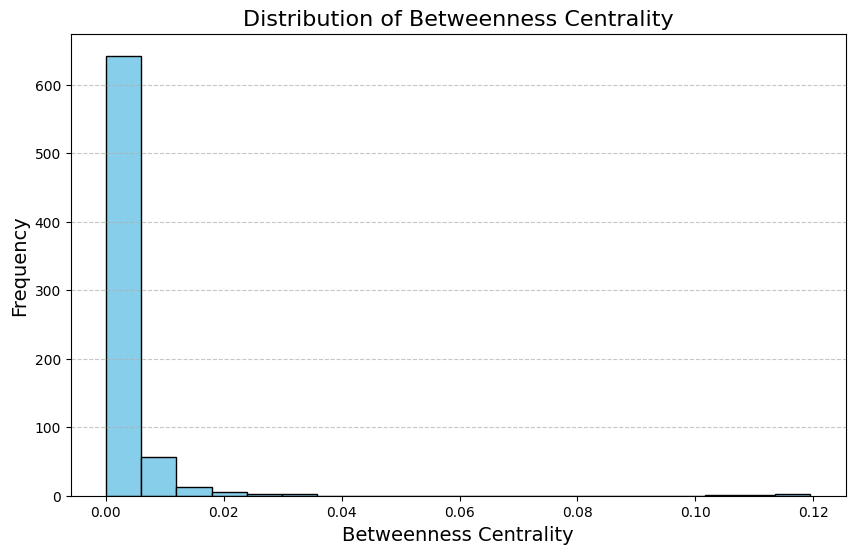

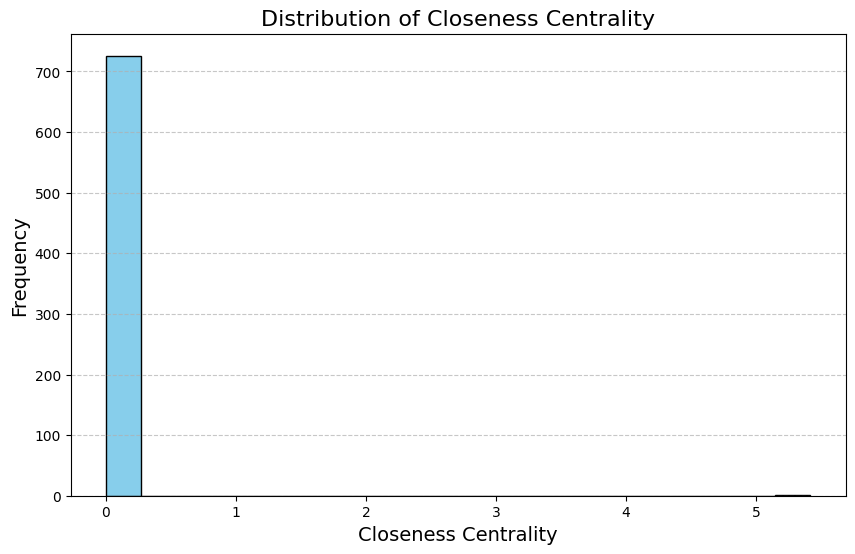

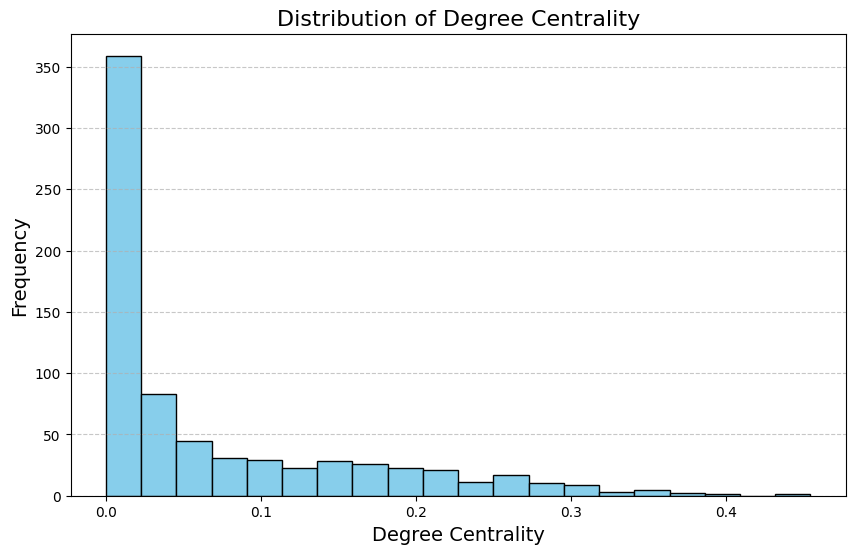

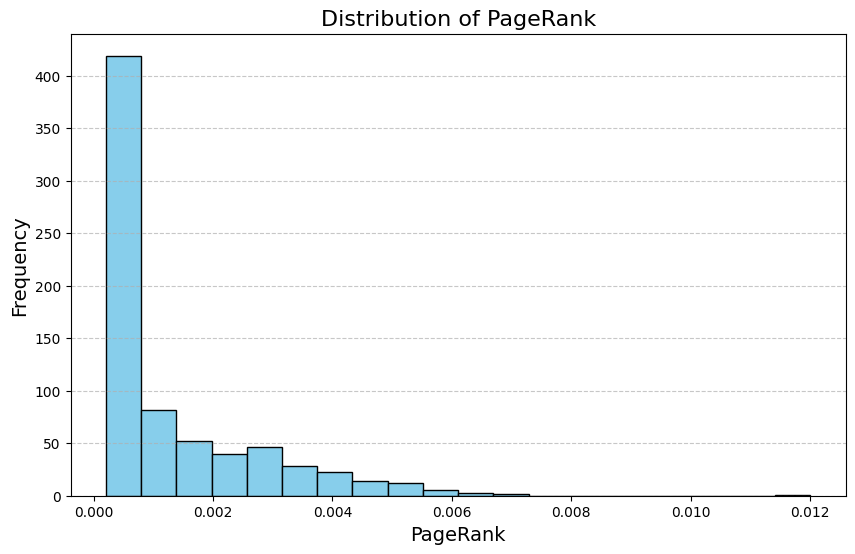

Top 5 values for Betweenness Centrality
MTN 0.1195421297615655
WFB 0.11870618409803363
YIP 0.11105918115322504
KTN 0.1048940818846775
MEM 0.03515341502802318

Top 5 values for Closeness Centrality
FVS 5.417910447761194
STL 0.001125822268950566
CMI 0.0011246380942496294
DEC 0.0011228100564188855
SPI 0.0011221713861753432

Top 5 values for Degree Centrality
YIP 0.45454545454545453
MSP 0.39944903581267216
MEM 0.38016528925619836
MCI 0.37327823691460055
ATL 0.35537190082644626

Top 5 values for PageRank
YIP 0.012006151447462827
SHV 0.0072216887807756685
MSP 0.007160893207347715
MEM 0.006679670164314872
MCI 0.00666107584866181



In [ ]:
compare_centralities(airport_graph)

### 2.3 Ask LLM (eg. ChatGPT) to suggest alternative centrality measures that might be relevant to this task. How can you check that the results given by the LLM are trustable?

#### (ChatGPT answer) **Alternative Centrality Measures for Airport Graphs**

When analyzing airport graphs, here are some alternative centrality measures that might be relevant:

1. **Eigenvector Centrality**:
   - Captures the influence of a node in a network, considering not just the degree of a node but also the importance of its neighbors. In the context of airport graphs, this can highlight airports that are connected to other highly connected airports.

2. **Katz Centrality**:
   - Similar to eigenvector centrality but includes a damping factor to avoid infinite weight accumulation in strongly connected graphs. It assigns more importance to nodes that are closer.

3. **Harmonic Centrality**:
   - Focuses on accessibility by giving higher scores to nodes that are closer to others. Unlike closeness centrality, it handles disconnected nodes better by using the reciprocal of the distance.

4. **Clustering Coefficient**:
   - Measures how tightly a node's neighbors are connected to each other. For an airport graph, it can identify airports that act as hubs for regional clusters.

5. **Edge Betweenness Centrality**:
   - Instead of focusing on nodes, this measure focuses on edges, identifying the most critical routes in the network.

6. **Accessibility Index**:
   - Measures how many unique destinations can be reached directly or indirectly from a given airport within a certain distance or hop limit.

### 2.4 Implement one of these measures suggested by the LLM, compare its results to the centralities you've already computed, and analyze whether it adds any new insights.

Let's compute one of additional centrality measures: ***Eigenvector centrality***

**Eigenvector centrality** measures the influence of a node in the graph, taking into account not only the number of connections (edges) a node has but also the quality of those connections.

It can be useful for identifying major hub airports that are connected to other highly connected airports.

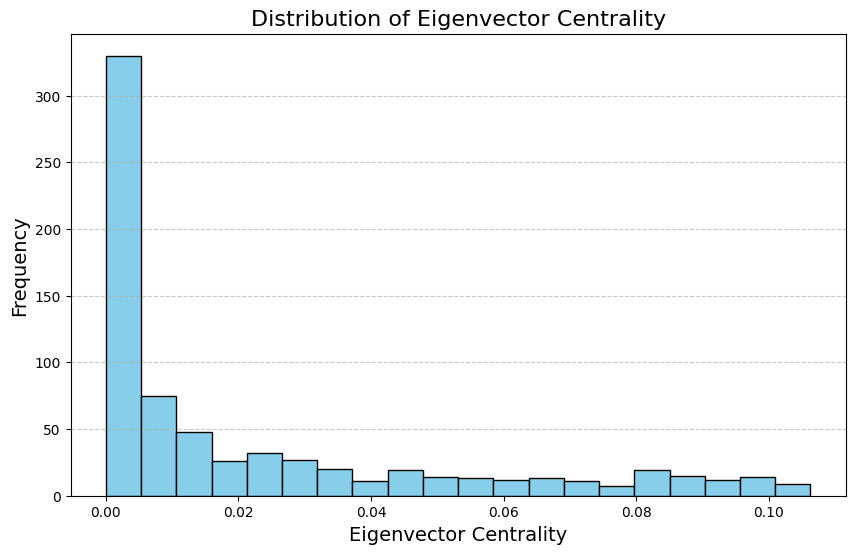

Top 5 values for Eigenvector centrality

MSP 0.10626254910289
ORD 0.1055844146784525
ATL 0.10465295947305311
MEM 0.10455190260902224
IND 0.10261881099435556


In [ ]:
# Calculate eigenvector centrality for each node of the graph and return a dictionary of values
eigen_dict = airport_graph.eigenvector_centrality()

# Plot histogram of eigenvector centrality values for all node in the graph
plot_metrics(eigen_dict, "Eigenvector Centrality")

print('Top 5 values for Eigenvector centrality\n')

# Print top 5 airport for eigenvector centrality value
for key, value in list(sorted(eigen_dict.items(), key=lambda item:item[1], reverse=True))[:5]:
    print(key, value)

Let's use **networkx** to implement the same graph, this will be used to compare results of centralities

In [ ]:
def create_graph_from_dataframe(df):
    """
    Creates a directed graph from a DataFrame.
    
    Parameters:
    - df: DataFrame containing data with at least the columns 'Origin_airport', 'Destination_airport', and 'Distance'.
    
    Returns:
    - G: NetworkX directed graph with edges weighted by the 'Distance' column.
    """
    # Create a directed graph
    G = nx.DiGraph()
    
    # Add edges to the graph
    for _, row in df.iterrows():
        origin = row['Origin_airport']
        destination = row['Destination_airport']
        distance = row['Distance']
        
        # Add edge only if a valid distance exists
        if pd.notna(distance):
            G.add_edge(origin, destination, weight=distance)
    
    return G

# Create net_x graph
net_x_graph = create_graph_from_dataframe(df)

Networkx Centralities 

In [ ]:
# Calculate centralities using networkx graph and built-in functions to compare results with our centralities
def analyze_networkx_centrality(net_x_graph, airport):
    print(f"Betweeness centrality = {nx.betweenness_centrality(net_x_graph)[airport]}")
    print(f"Closeness centrality = {nx.closeness_centrality(net_x_graph, distance="weight")[airport]}")
    print(f"Degree centrality = {nx.in_degree_centrality(net_x_graph)[airport]}")
    print(f"Pagerank = {nx.pagerank(net_x_graph)[airport]}")
    print(f"Eigenvector centrality = {nx.eigenvector_centrality(net_x_graph)[airport]}")

analyze_networkx_centrality(net_x_graph, "JFK")

Betweeness centrality = 0.017449699445290113
Closeness centrality = 0.0007772548815887355
Degree centrality = 0.26584022038567495
Pagerank = 0.006497277633515799
Eigenvector centrality = 0.08200786154257055


Our Centralities

In [ ]:
analyze_centrality(airport_graph, "JFK")

betweeness_centrality = 0.006976346537475064
closeness_centrality = 0.0008531651133029124
degree_centrality = 0.26584022038567495
pagerank_centrality = 0.0045783920207815194


In [ ]:
airport_graph.eigenvector_centrality()['JFK']

np.float64(0.0941568443767929)

## 5. Finding and Extracting Communities (Q5)

Airlines can optimize their operations by identifying communities within a flight network. These communities represent groups of airports with strong connections, helping airlines pinpoint high-demand regions for expansion or underserved areas for consolidation. By analyzing these communities, airlines can improve resource allocation, reduce costs, and enhance service quality.

### 5.1 In this task, you are asked to analyze the graph and identify the communities based on the flight network provided. For the airline, the primary focus is on the cities, so your communities should reflect the connectivity between cities through the flights that link them.

In [2]:
df = pd.read_csv("Airports2_updated_no_duplicate.csv")

df.shape

(3600286, 15)

In [3]:
airports_data = df

# Select only columns needed
airports_data = airports_data[[
        'Origin_airport', 
        'Origin_city',
        'Destination_airport', 
        'Destination_city',
    ]]

# Remove duplicated rows
airports_unique = airports_data.drop_duplicates()

airports_unique.shape


airports_unique_filtered = (airports_unique[airports_unique['Origin_city'] != airports_unique['Destination_city']])
filtered_df = (airports_unique_filtered[airports_unique_filtered['Origin_airport'] != airports_unique_filtered['Destination_airport']])

filtered_df.shape

(36304, 4)

In [4]:
sampled_df = filtered_df.sample(frac=0.005, random_state=42, ignore_index=True)
sampled_df.shape

(182, 4)

Class to define the graph

In [9]:
import numpy as np
from sklearn.cluster import KMeans, SpectralClustering
import networkx as nx

class CityGraphUndirectedWeighted:
    def __init__(self):
        self.city_graph = {}  # Undirected city graph
        self.nodes = set()
        self.edges = set()
        self.n_nodes = 0
        self.n_edges = 0
        self.city_to_index = {}  # Maps cities to indices in the matrix
        self.index_to_city = {}  # Maps indices to cities

    def add_flight(self, city_a, city_b, airport_a, airport_b):
        # Add nodes if they don't exist
        if city_a not in self.city_graph:
            self.city_graph[city_a] = {'connections': {}}
            self.nodes.add(city_a)
        if city_b not in self.city_graph:
            self.city_graph[city_b] = {'connections': {}}
            self.nodes.add(city_b)

        # Unique identifier for undirected edges
        edge_key = frozenset([city_a, city_b])

        if city_b not in self.city_graph[city_a]['connections']:
            self.city_graph[city_a]['connections'][city_b] = {
                'n_routes': 1,
                'routes': [(airport_a, airport_b), (airport_b, airport_a)]
            }
            self.city_graph[city_b]['connections'][city_a] = self.city_graph[city_a]['connections'][city_b]
            self.edges.add(edge_key)
        else:
            existing_routes = self.city_graph[city_a]['connections'][city_b]['routes']
            new_route = (airport_a, airport_b)
            new_route_inverted = (airport_b, airport_a)

            if new_route not in existing_routes and new_route_inverted not in existing_routes:
                self.city_graph[city_a]['connections'][city_b]['routes'].append(new_route)
                self.city_graph[city_a]['connections'][city_b]['routes'].append(new_route_inverted)
                self.city_graph[city_a]['connections'][city_b]['n_routes'] += 1

    def get_graph(self):
        return self.city_graph

    def create_adjacency_matrix(self):
        self.city_to_index = {city: idx for idx, city in enumerate(self.city_graph.keys())}
        self.index_to_city = {idx: city for idx, city in enumerate(self.city_graph.keys())}

        size = len(self.city_graph)
        adj_matrix = np.zeros((size, size))

        for city_a in self.city_graph:
            for city_b, data in self.city_graph[city_a]['connections'].items():
                weight = data['n_routes']
                idx_a = self.city_to_index[city_a]
                idx_b = self.city_to_index[city_b]
                adj_matrix[idx_a][idx_b] = weight
                adj_matrix[idx_b][idx_a] = weight

        return adj_matrix

    def modularity(self, communities):
        m = self.adj_matrix.sum() / 2
        modularity = 0

        for community in set(communities):
            nodes_in_community = [i for i, c in enumerate(communities) if c == community]
            internal_weight = 0
            for i in nodes_in_community:
                for j in nodes_in_community:
                    if i != j:
                        internal_weight += self.adj_matrix[i][j]

            total_weight = 0
            for i in nodes_in_community:
                total_weight += self.adj_matrix[i].sum()

            modularity += internal_weight / (2 * m) - (total_weight / (2 * m))**2
        
        return modularity

    # Function that implement louvain method to find communities in our graph
    def louvain(self):
        self.adj_matrix = self.create_adjacency_matrix()
        communities = list(range(len(self.city_graph)))
        prev_modularity = -np.inf

        # Step 1 of Louvain Method 
        while True:
            for i in range(len(self.city_graph)):
                best_community = communities[i]
                best_modularity = self.modularity(communities)

                for j in range(len(self.city_graph)):
                    if i != j:
                        communities[i] = communities[j]
                        new_modularity = self.modularity(communities)
                        
                        if new_modularity > best_modularity:
                            best_modularity = new_modularity
                            best_community = communities[j]
                
                communities[i] = best_community

            modularity = self.modularity(communities)
            print(modularity - prev_modularity)

            if modularity - prev_modularity < 1e-6:
                break

            prev_modularity = modularity

        # Step 2 of Louvain Method: Aggregation of nodes in communities
        return self.aggregate_communities(communities), prev_modularity

    def aggregate_communities(self, communities):
        """
        Aggregates nodes belonging to the same community into a single node.
        Creates a new graph with communities as nodes and connections between communities as edges.
        """
        community_graph = {}
        for i, community in enumerate(communities):
            city = self.index_to_city[i]
            if community not in community_graph:
                community_graph[community] = {'nodes': [], 'connections': {}}
            community_graph[community]['nodes'].append(city)

        # Add edges between communities
        for city_a, data_a in self.city_graph.items():
            for city_b, data_b in data_a['connections'].items():
                comm_a = communities[self.city_to_index[city_a]]
                comm_b = communities[self.city_to_index[city_b]]
                
                if comm_a != comm_b:
                    if comm_b not in community_graph[comm_a]['connections']:
                        community_graph[comm_a]['connections'][comm_b] = 0
                    community_graph[comm_a]['connections'][comm_b] += data_b['n_routes']

        print("New community graph len", len(community_graph))

        # Returns a new aggregated graph with communities as nodes
        return community_graph
    
    def group_nodes_by_community(self, communities):
        # Creates a dictionary to group cities by community
        community_groups = {}

        for idx, community_id in enumerate(communities):
            # Retrieve the city name corresponding to the index
            city_name = self.index_to_city[idx]

            # Add the city to the community group
            if community_id not in community_groups:
                community_groups[community_id] = []
            community_groups[community_id].append(city_name)

        return community_groups
    
    def filter_graph_by_connections(self, threshold=1):
        """
        Filters the graph to keep only nodes (cities) with more than one connection.
        """
        # Filter the graph
        # Filter nodes: keep only cities with more than one connection
        filtered_graph = {
            city: data
            for city, data in self.city_graph.items()
            if len(data['connections']) > threshold
        }

        # Update nodes
        self.nodes = set(filtered_graph.keys())
        self.n_nodes = len(self.nodes)

        # Update edges: keep only those between remaining nodes
        filtered_edges = set()
        for city_a, data in filtered_graph.items():
            for city_b, weight in data['connections'].items():
                if city_b in self.nodes:  # Keep only valid connections
                    edge_key = frozenset([city_a, city_b])  # Use a frozenset as edge identifier
                    filtered_edges.add(edge_key)

        # Update the graph with valid connections
        self.city_graph = {
            city: {
                "connections": {
                    neighbor: weight
                    for neighbor, weight in data["connections"].items()
                    if neighbor in self.nodes
                }
            }
            for city, data in filtered_graph.items()
        }

        # Update edge attributes
        self.edges = filtered_edges  # Only frozenset edges
        self.n_edges = len(self.edges)

        # Update city <-> index mappings
        self.city_to_index = {city: idx for idx, city in enumerate(self.city_graph.keys())}
        self.index_to_city = {idx: city for city, idx in self.city_to_index.items()}

    def spectral_clustering(self, n_clusters=2):
        """
        Applies spectral clustering to find communities in the graph.

        :param n_clusters: Number of clusters/communities to find.
        :return: A dictionary grouping nodes by community.
        """
        # Create the adjacency matrix
        adj_matrix = self.create_adjacency_matrix()

        # Apply spectral clustering
        spectral = SpectralClustering(
            n_clusters=n_clusters,
            affinity='precomputed',  # Use the adjacency matrix as affinity
            random_state=42
        )
        labels = spectral.fit_predict(adj_matrix)

        # Group nodes by community
        communities = self.group_nodes_by_community(labels)
        return communities
    
    def spectral_clustering_scratch(self, num_clusters):
        # Create the adjacency matrix
        adj_matrix = self.create_adjacency_matrix()
        
        # Ensure the adjacency matrix is symmetric
        adj_matrix = (adj_matrix + adj_matrix.T) / 2

        # Compute the Laplacian matrix
        degree_matrix = np.diag(np.sum(adj_matrix, axis=1))  # Degree matrix
        laplacian_matrix = degree_matrix - adj_matrix  # Laplacian matrix

        # Compute eigenvectors of the Laplacian matrix
        eigvals, eigvecs = np.linalg.eigh(laplacian_matrix)

        # Select eigenvectors associated with the smallest eigenvalues
        # (typically the first k eigenvectors)
        sorted_indices = np.argsort(eigvals)[:num_clusters]
        selected_eigvecs = eigvecs[:, sorted_indices]

        # Apply K-means on the selected eigenvectors
        kmeans = KMeans(n_clusters=num_clusters, random_state=42)
        kmeans.fit(selected_eigvecs)

        return self.group_nodes_by_community(kmeans.labels_)

    # Function to convert our graph (dictionary) to networkx graph
    def to_networkx(self):
        G = nx.Graph()
        for city_a, data in self.city_graph.items():
            for city_b, conn_data in data['connections'].items():
                G.add_edge(city_a, city_b, weight=conn_data['n_routes'])
        return G


Function to visualize the graph highlighting the communities within the network (each community with different color)

In [20]:
import networkx as nx
import matplotlib.pyplot as plt
from itertools import cycle
import random

def plot_graph(city_graph_undirected, communities):
    # Create the graph from city_graph_undirected
    G = city_graph_undirected.to_networkx()

    # Map nodes to their communities
    node_to_community = {}
    for community_id, community_data in communities.items():
        for node in community_data['nodes']:
            node_to_community[node] = community_id

    # Define a unique color for each community
    community_ids = list(set(node_to_community.values()))
    color_cycle = cycle(plt.cm.tab20.colors)  # A sequence of colors
    community_colors = {community_id: color for community_id, color in zip(community_ids, color_cycle)}

    # Assign colors to nodes based on their community
    node_colors = [community_colors[node_to_community.get(node, -1)] for node in G.nodes()]

    # Determine node positions
    pos = nx.spring_layout(G, seed=42)  # Use a "spring" layout for node positioning

    # Draw the graph
    plt.figure(figsize=(20, 15))

    # Draw nodes with community colors
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=500, alpha=0.9)

    # Draw edges
    nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.5)

    # Draw node labels
    nx.draw_networkx_labels(G, pos, font_size=10, font_color="black", font_weight="bold")

    # Add a legend for the communities
    for community_id, color in community_colors.items():
        plt.scatter([], [], color=color, label=f"Community {community_id}", s=100)

    # Add title and display
    plt.title("City Graph Colored by Communities", fontsize=16)
    plt.axis("off")
    plt.show()


Required function

In [ ]:
def check_community(city_1, city_2):

    city_graph_undirected = CityGraphUndirectedWeighted()

    # Fill Graph
    for index, row in sampled_df.iterrows():
        city_graph_undirected.add_flight(
            row['Origin_city'],
            row['Destination_city'],
            row['Origin_airport'],
            row['Destination_airport']
        )

    # Count how many nodes and edges are in the graph
    city_graph_undirected.n_nodes = len(city_graph_undirected.nodes)
    city_graph_undirected.n_edges = len(city_graph_undirected.edges)

    print(city_graph_undirected.n_nodes, city_graph_undirected.n_edges)

    # Filter graph removing nodes that has less than 2 routes
    city_graph_undirected.filter_graph_by_connections(1)

    print("After filtering", city_graph_undirected.n_nodes, city_graph_undirected.n_edges)

    # Use Louvain method to compute communities
    communities, modularity = city_graph_undirected.louvain()

    print("Total modularity", modularity)
    print("Total number of communities is", len(communities))

    print()

    print("Communities:")

    # Print communities and search for communities of given cities
    for idx, comm in communities.items():
        print(f"Community {idx}, {comm['nodes']}")

        if city_1 in comm['nodes']: comm_1 = idx
        if city_2 in comm['nodes']: comm_2 = idx

    print()

    # Print if cities are in the same or different communities
    if comm_1 == comm_2: 
        print(f"{city_1} and {city_2} in the same community n:{comm_1}")
    else:
        print(f"{city_1} and {city_2} are not in the same community")
        print(f"{city_1} is in community {comm_1}")
        print(f"{city_2} is in community {comm_2}")

    # Plot graph colored by community
    plot_graph(city_graph_undirected, communities)
        

In [ ]:
check_community('Tallahassee, FL', 'Miami, FL')

### 5.2 Ask a LLM (ChatGPT, Claude AI, Gemini, Perplexity, etc.) to suggest an alternative algorithm for extracting communities and explain the steps required to implement it. Then, implement this algorithm and compare its results with the current method you've chosen. Discuss the differences in the outcomes and analyze which approach you think is better, providing reasons for your choice.

Spectral Clustering is based on the analysis of adjacency matrices. It uses eigenvalue decomposition to reduce the dimensionality of the graph and then applies a clustering method (e.g., k-means) on the eigenvectors obtained from the decomposition.

To implement Spectral Clustering in our CityGraphUndirectedWeighted class, we can follow these main steps:

- Construct the adjacency matrix of the graph.
- Calculate the Laplacian matrix of the graph, which is a transformation of the adjacency matrix.
- Calculate the eigenvectors of the Laplacian matrix. These eigenvectors can be used to reduce dimensionality.
- Apply a clustering algorithm (such as K-means) on the obtained eigenvectors.

In [19]:
city_graph = CityGraphUndirectedWeighted()

# Fill Graph
for index, row in sampled_df.iterrows():
    city_graph.add_flight(
        row['Origin_city'],
        row['Destination_city'],
        row['Origin_airport'],
        row['Destination_airport']
    )

city_graph.n_nodes = len(city_graph.nodes)
city_graph.n_edges = len(city_graph.edges)

# Execute clustering with 10 communities
num_clusters = 10

# Use spectral clustering to compute communities
communities = city_graph.spectral_clustering(num_clusters)

print("Total number of communities", len(communities))
print()

# Print communities
for community, cities in communities.items():
    print(f"Comunità {community}: {', '.join(cities)}")


Total number of communities 10

Comunità 1: Tallahassee, FL, Miami, FL, Roanoke, VA, Detroit, MI, North Platte, NE, Dubuque, IA, Sumter, SC, Sioux Falls, SD, Toledo, OH, Saginaw, MI, Peoria, IL, Chattanooga, TN, Jacksonville, FL, Wilmington, NC, Sandusky, OH, Wichita, KS, College Station, TX, St. Louis, MO, Gillette, WY, Augusta, GA, Cincinnati, OH, Phoenix, AZ, Colorado Springs, CO, Houston, TX, Waco, TX, Corpus Christi, TX, Pittsburgh, PA, Washington, DC, Scottsbluff, NE, Grand Junction, CO, Santa Ana, CA, Sacramento, CA, Sioux City, IA, Allentown, PA, Topeka, KS, Springfield, IL, Punta Gorda, FL, Wichita Falls, TX, Elko, NV, Napa, CA, Omaha, NE, Green Bay, WI, El Paso, TX, Memphis, TN, Jackson, MS, Newark, NJ, Huntsville, AL, Hot Springs, AR, San Jose, CA, Wausau, WI, Pueblo, CO, Mobile, AL, Monroe, LA, Elmira, NY, Milwaukee, WI, Beaumont, TX, Fort Lauderdale, FL, San Francisco, CA, Rapid City, SD, Williston, ND, Burlington, VT, Syracuse, NY, Buffalo, NY, Lubbock, TX, Big Spring, TX

c:\Users\Alessio\anaconda3\Lib\site-packages\sklearn\manifold\_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
c:\Users\Alessio\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
